## **Dataset Overview**
This notebook prepares a custom dataset used for training the models in the paper 'A Lightweight, Real-Time Person Detection
System for Aerial Search and Rescue'. Outside of this notebook datasets were loaded, annotated and augmented inside [Roboflow](https://roboflow.com/) a popular image annotation tool.

- **Datasets**: In total there are 5 datasets, all contain SAR-related images with 'person' class annotations. 4 of the datasets were gathered online, 1 was created and annotated by myself to address a lack of available data of person detection in desert / mountainous scenarios.
- **Labels**: Images are categorized under AlSAR (Alpine Search and Rescue), WiSAR (Wilderness Search and Rescue) & MaSAR (Maritime Search and Rescue). To show the lack of desert terrain in the WiSAR class - I tag WiSAR images into 3 further classes WiSAR-forest, WiSAR-grassland, WiSAR-desert

*Label Descriptions*
- AlSAR, Mountainous terrain with potential hazards like snow / ice, rock, and steep slopes
- WiSAR, Undeveloped areas like forests, deserts, or grassland - these were tagged further.
- MaSAR, Open water (oceans, seas, large lakes) including coastlines

- **Data Directories**:
All Datasets were saved on my personal google drive - and I use this throughout the code - these parts need to be changed - if you want to run the notebook

In [ ]:

import shutil
from IPython.display import Image, display, HTML
from PIL import Image as PILImage
import random
import matplotlib.pyplot as plt
import os
import json
import matplotlib.patches as patches
from torchvision.datasets import CocoDetection
import torchvision.transforms as transforms
import numpy as np
import os
import json
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter
import random
import json
import os
import random
!pip install orjson
!pip install opencv-python-headless pillow
import orjson
import cv2
import os
import json
import matplotlib.pyplot as plt
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
dataset_dir = '/content/drive/My Drive/Dissertation/Datasets/Labelled Datasets/'

In [ ]:
# Define the function to visualize wilderness pie chart based on tag counts
def show_wilderness_pie_chart(tag_counts):
    sub_categories = ['WiSAR-forest', 'WiSAR-desert', 'WiSAR-grassland']
    sub_counts = [tag_counts.get(tag, 0) for tag in sub_categories]
    sub_labels = [tag.split('-')[1].capitalize() for tag in sub_categories]
    sub_colors = ['forestgreen', 'sandybrown', 'mediumseagreen']

    plt.figure(figsize=(8, 8))
    plt.pie(sub_counts, labels=sub_labels, colors=sub_colors, autopct='%1.1f%%', startangle=140)
    plt.title('WiSAR Images Subcategories Distribution')
    plt.show()

# Define the function to show the environment split
def show_environment_split(dir, show_wilderness_split=False,folder='train',dont_count_synthetic=False):
    # Construct the full path to the annotations file
    ann_file = os.path.join(dir, folder, '_annotations.coco.json')

    # Check if the annotations file exists
    if not os.path.isfile(ann_file):
        print(f"File not found: {ann_file}")
        return

    # Load JSON data
    with open(ann_file, 'r') as f:
        data = json.load(f)

    # Initialize a dictionary to count tags
    tag_counts = {'MaSAR': 0, 'AlSAR': 0, 'WiSAR': 0, 'WiSAR-forest': 0, 'WiSAR-desert': 0, 'WiSAR-grassland': 0}

    # Process each image's tags to update counts
    for image in data['images']:
        tags = image.get("extra", {}).get("user_tags", [])
        if dont_count_synthetic == True and "synthetic" in tags:
          continue
        for tag in tags:
            if 'MaSAR' in tag or 'MiSAR' in tag:
                tag_counts['MaSAR'] += 1
            if 'AlSAR' in tag:
                tag_counts['AlSAR'] += 1
            if 'WiSAR' in tag:
                tag_counts['WiSAR'] += 1
                if 'forest' in tag:
                    tag_counts['WiSAR-forest'] += 1
                if 'desert' in tag:
                    tag_counts['WiSAR-desert'] += 1
                if 'grassland' in tag:
                    tag_counts['WiSAR-grassland'] += 1


    # Plot SAR types count bar chart
    plt.figure(figsize=(10, 6))
    sar_types = ['MaSAR', 'AlSAR', 'WiSAR']
    counts = [tag_counts[sar] for sar in sar_types]
    bars = plt.bar(sar_types, counts, color=['blue', 'green', 'red'])
    plt.title('Count of SAR Images by Type')
    plt.xlabel('Search and Rescue Types')
    plt.ylabel('Image Counts')

    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2.0, height, '%d' % int(height), ha='center', va='bottom', fontsize=14)

    plt.tight_layout()
    plt.show()

    # Display WiSAR subcategories distribution if requested
    if show_wilderness_split:
        show_wilderness_pie_chart(tag_counts)

    return tag_counts


In [ ]:
def display_image(image_array):
    """
    Display an image given as a NumPy array.
    :param image_array: NumPy array representing the image.
    """
    plt.imshow(cv2.cvtColor(image_array, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

In [ ]:
def get_first_image_path(folder_path):
    """
    Gets the path of the first image file in the given folder.
    Assumes that files are sorted in lexicographical order.
    :param folder_path: Path to the folder containing the images.
    :return: The path of the first image file.
    """
    # Get all items in the folder
    all_items = os.listdir(folder_path)

    # Filter out entries that are not files or not image files
    image_files = [f for f in all_items if os.path.isfile(os.path.join(folder_path, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif'))]

    # Sort the image files to ensure consistent order
    image_files.sort()

    # Return the first image file path
    if image_files:
        return os.path.join(folder_path, image_files[0])
    else:
        return None  # No images found



In [ ]:
def visualize_image(img, annotations):
    plt.figure(figsize=(10, 10))
    plt.imshow(img.permute(1, 2, 0))  # Convert from PyTorch to Matplotlib format

    ax = plt.gca()
    for annotation in annotations:
        bbox = annotation['bbox']
        rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3], linewidth=2, edgecolor='r', facecolor='none')
        ax.add_patch(rect)
    plt.show()

def visualize_dataset(dir,randomize=False):
    coco_path = dir
    ann_file = os.path.join(coco_path, 'train', '_annotations.coco.json')  # Verify this path is correct


    # Initialize the dataset
    coco_dataset = CocoDetection(root=os.path.join(coco_path, 'train'),  # Verify this is where your images are
                                 annFile=ann_file,
                                 transform=transforms.ToTensor())

    for i in range(3):
        if randomize == True:
          i = random.randint(0,len(coco_dataset)-1)

        img, annotations = coco_dataset[i]
        visualize_image(img, annotations)
    print(f'Number of images in dataset {len(coco_dataset)}')


    return len(coco_dataset)

# [SARD Dataset](https://ieee-dataport.org/documents/search-and-rescue-image-dataset-person-detection-sard)
The dataset contains 2086 labelled images from various terrains, mostly grasslands and forests. Most of these images fall under the WiSAR terrain group.

loading annotations into memory...
Done (t=17.37s)
creating index...
index created!


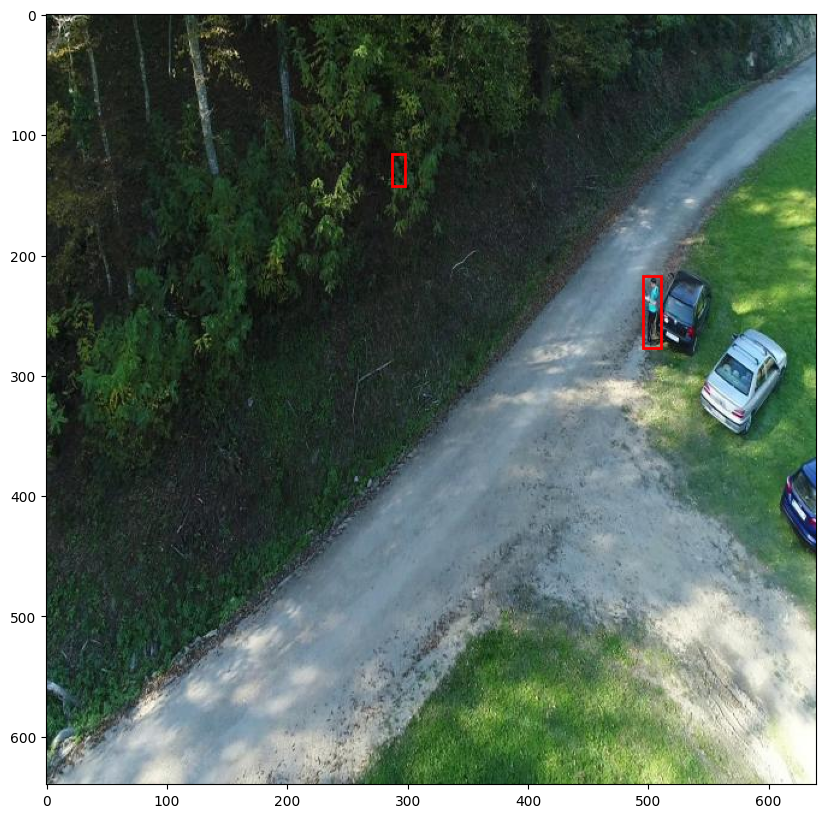

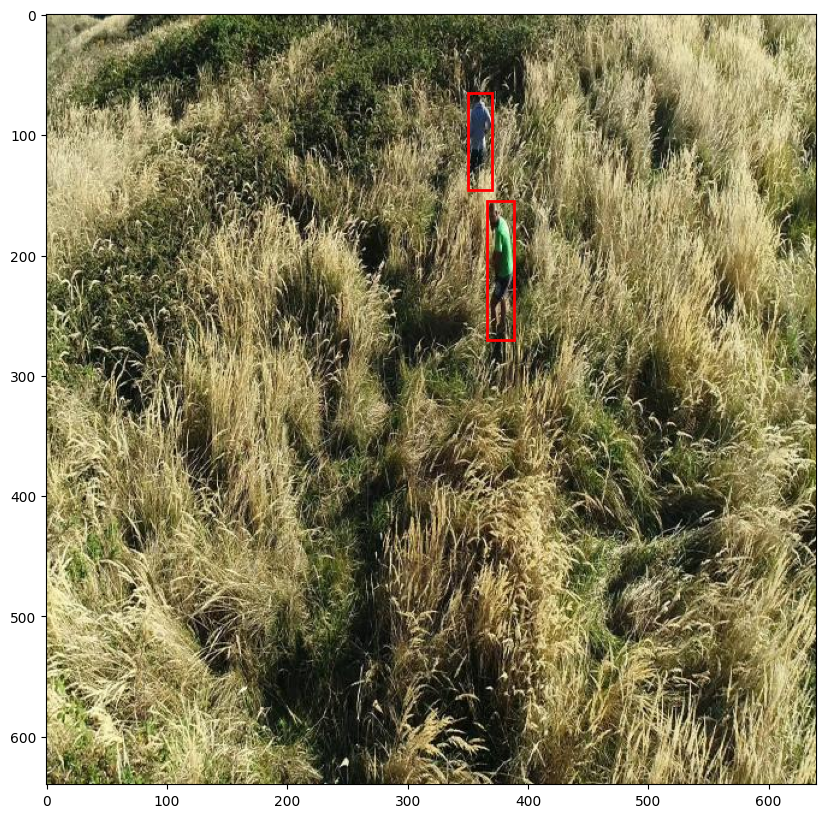

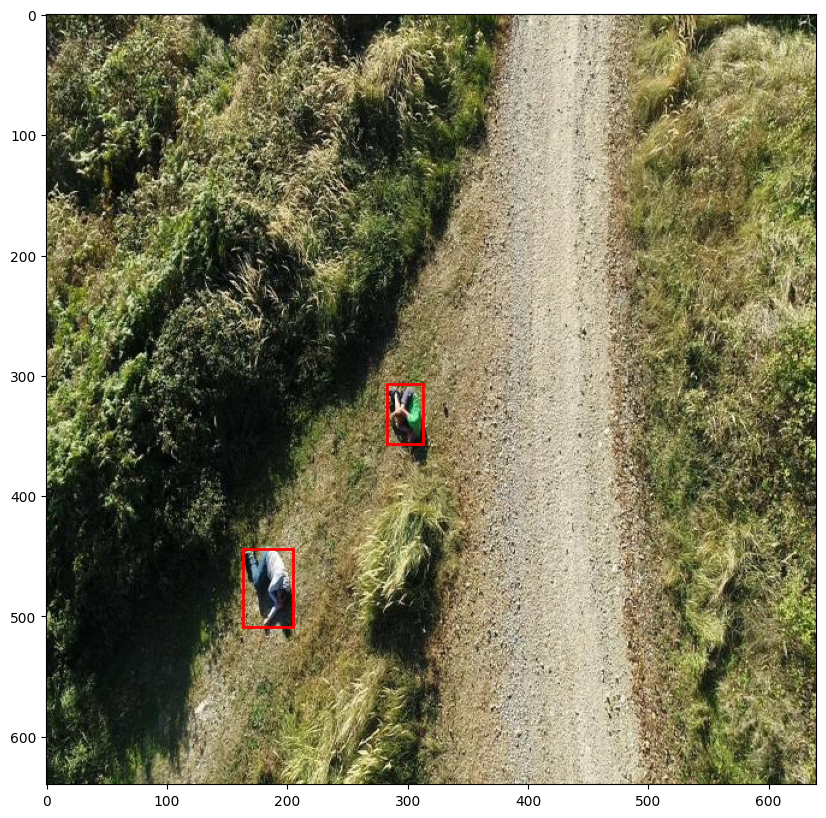

Number of images in dataset 2086


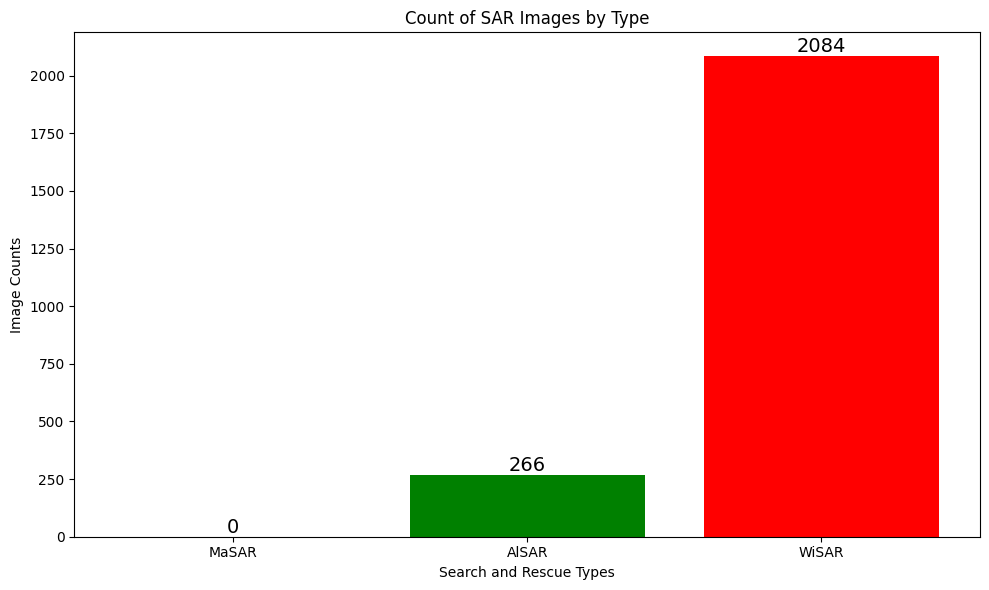

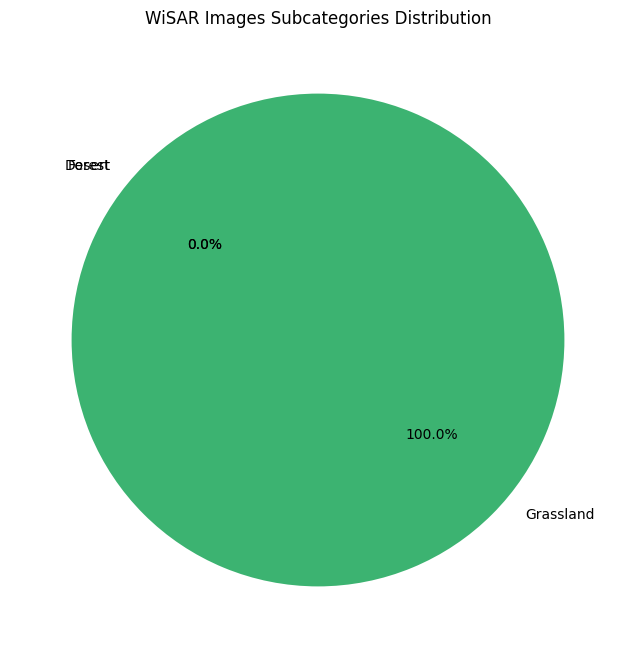

{'MaSAR': 0,
 'AlSAR': 266,
 'WiSAR': 2084,
 'WiSAR-forest': 0,
 'WiSAR-desert': 0,
 'WiSAR-grassland': 2084}

In [ ]:
# !unzip -o '/content/drive/My Drive/Dissertation/Datasets/Labelled Datasets/SARD.v3i.coco.zip' -d '/content/drive/My Drive/Dissertation/Datasets/Labelled Datasets/' -x '__MACOSX/*'

sard = dataset_dir + 'SARD.v3i.coco'

sard_count = visualize_dataset(sard)
show_environment_split(sard,show_wilderness_split=True)

# [SeaDroneSee](https://seadronessee.cs.uni-tuebingen.de/dataset)
The dataset contains over 10,000 labelled images from MaSAR scenarios, nearly all taken from far at sea. Some images from the original datset such as images exclusively containing boats, synthetic images and extremely blurry/ close to duplicated images have been removed; resulting in a dataset containing 5083 images.


loading annotations into memory...
Done (t=64.15s)
creating index...
index created!


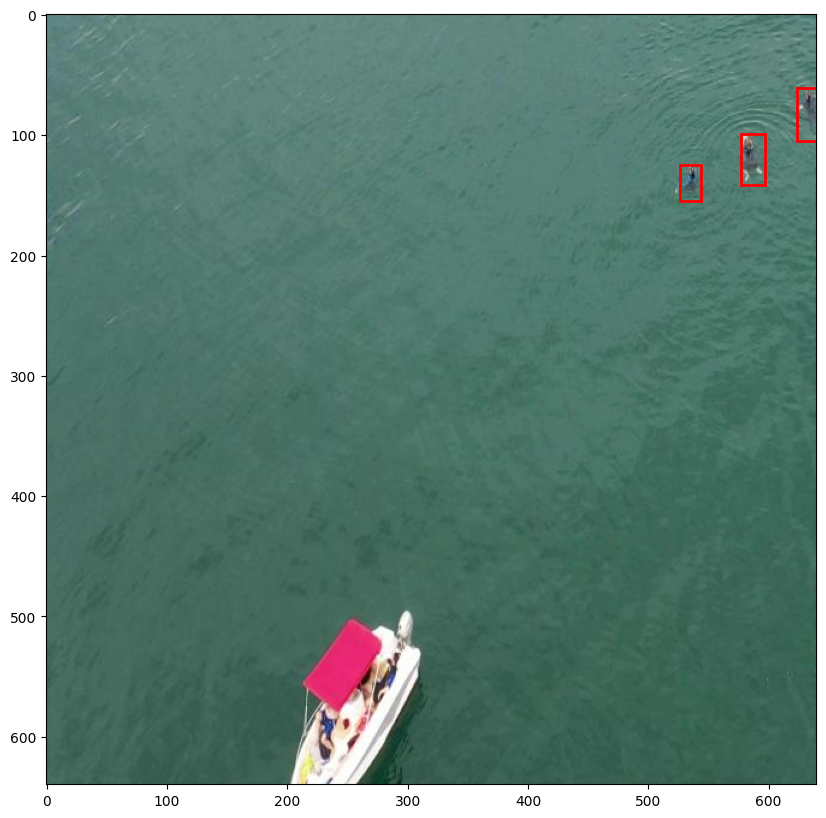

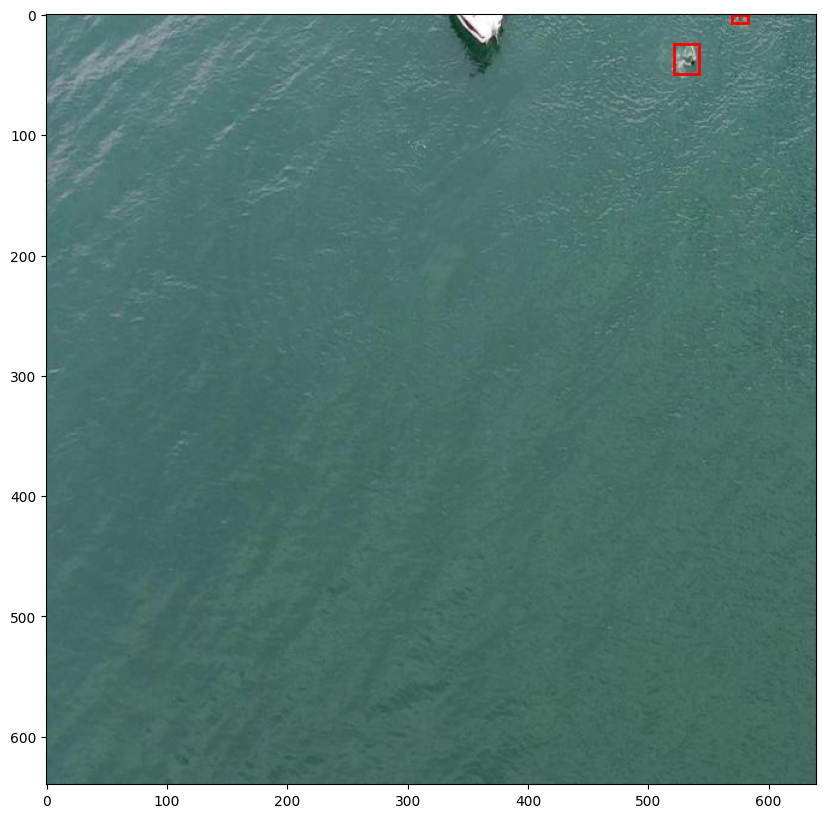

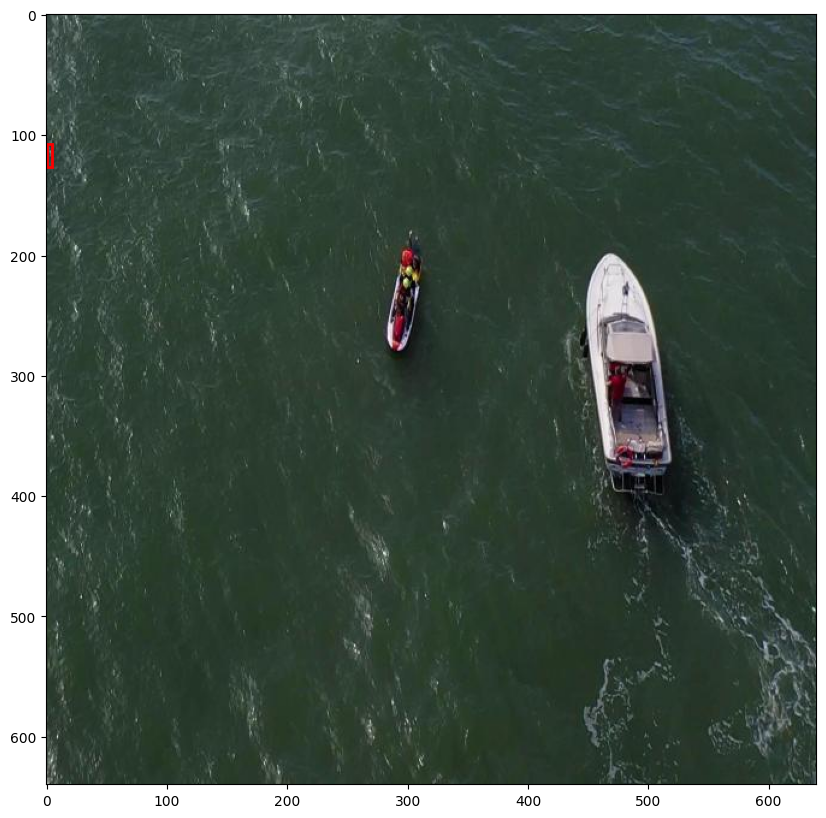

Number of images in dataset 5083


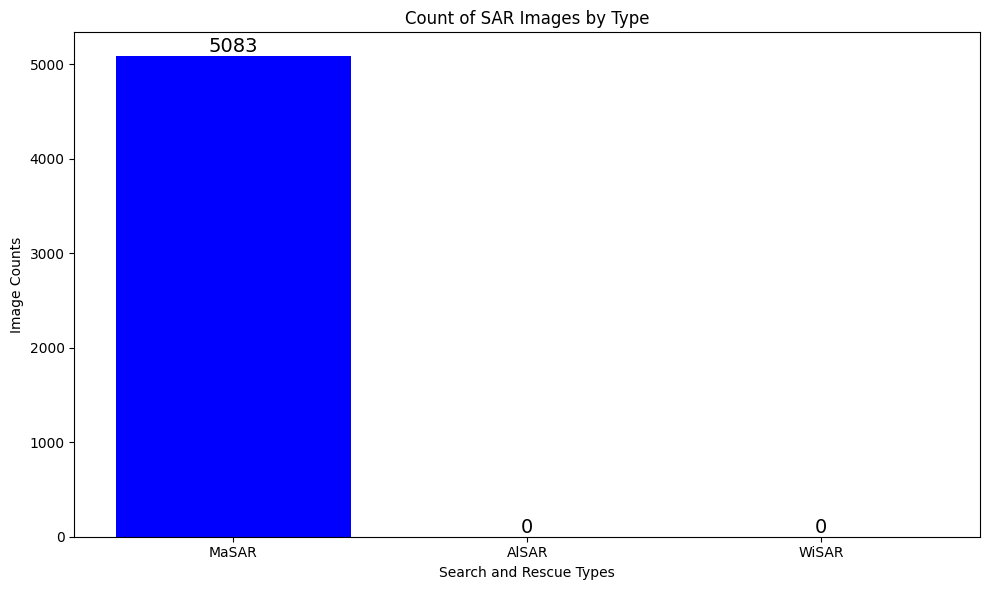

{'MaSAR': 5083,
 'AlSAR': 0,
 'WiSAR': 0,
 'WiSAR-forest': 0,
 'WiSAR-desert': 0,
 'WiSAR-grassland': 0}

In [ ]:
# !unzip -o '/content/drive/My Drive/Dissertation/Datasets/Labelled Datasets/SeaDroneSee.v1i.coco' -d '/content/drive/My Drive/Dissertation/Datasets/Labelled Datasets/' -x '__MACOSX/*'

sea = dataset_dir + 'SeaDroneSee.v1i.coco'
sea_count = visualize_dataset(sea)
show_environment_split(sea,show_wilderness_split=False)

# [WiSARD Dataset](https://sites.google.com/uw.edu/wisard/home)
The dataset comprises of more than 10,000 labeled images, predominantly of forest terrains. It has been curated by removing certain types of images, such as thermal imagery, from the original collection. Moreover, a significant portion of the initial dataset, which did not offer a drone's perspective or focus on aerial views of individuals, was excluded. After these adjustments, the dataset we use is now just 2999 images.


loading annotations into memory...
Done (t=22.42s)
creating index...
index created!


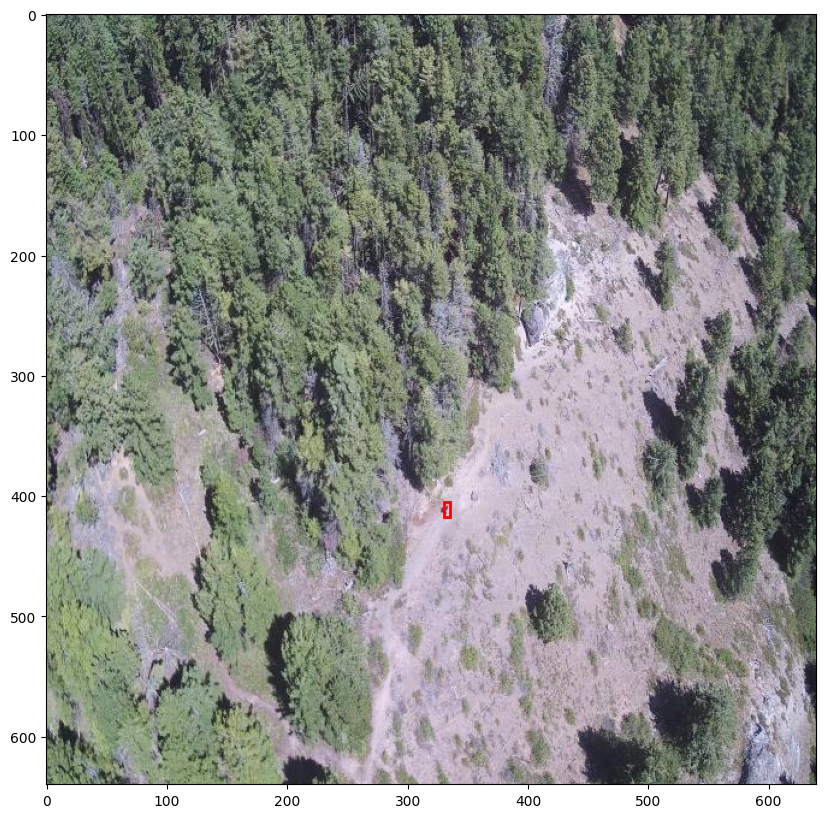

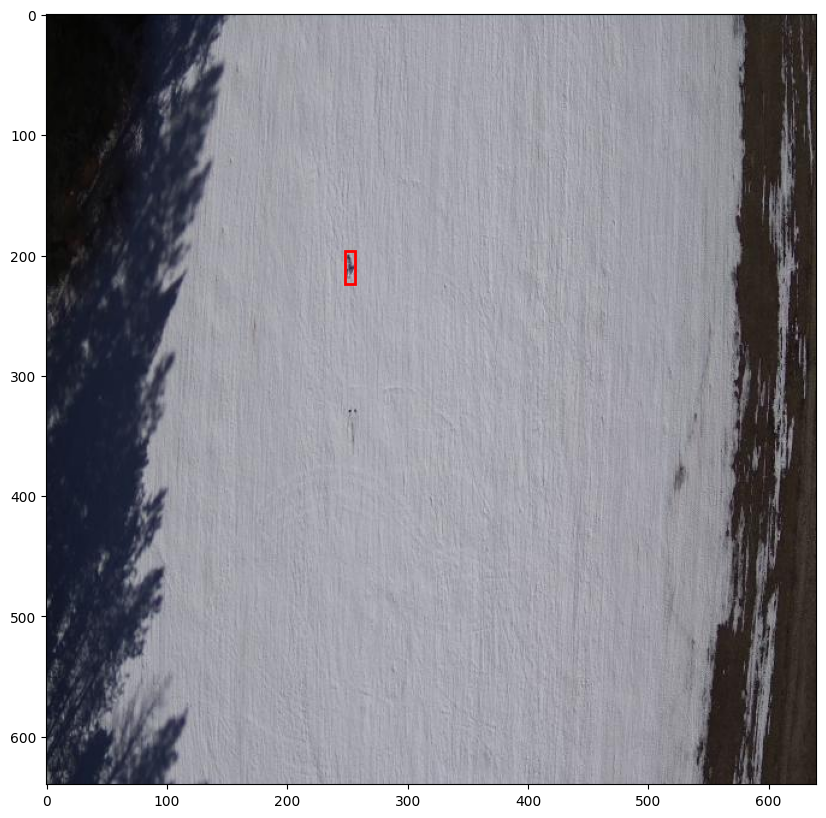

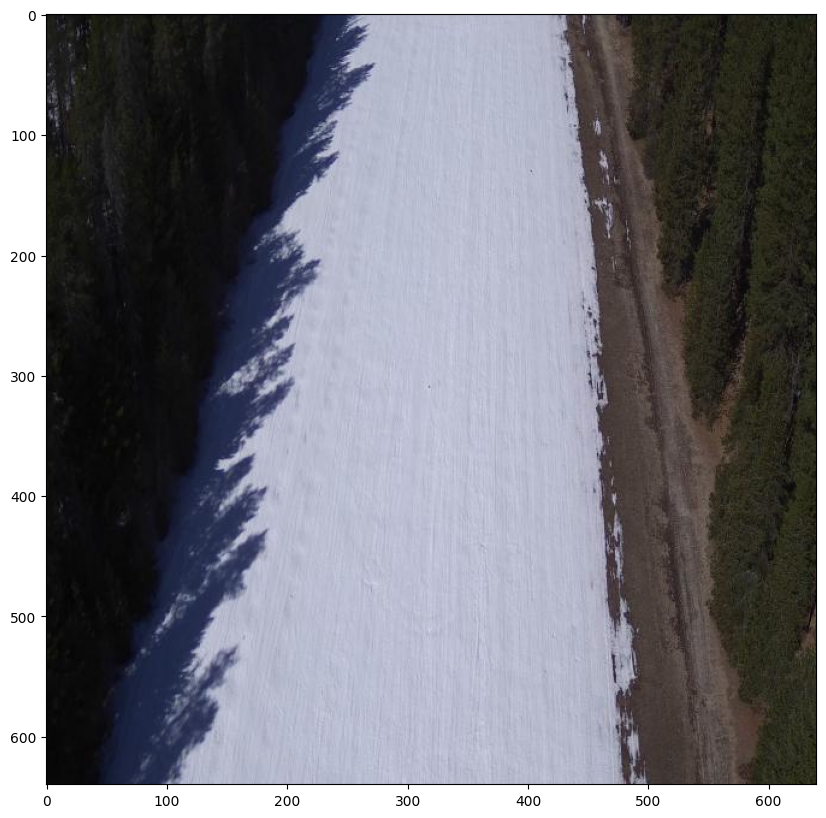

Number of images in dataset 2999


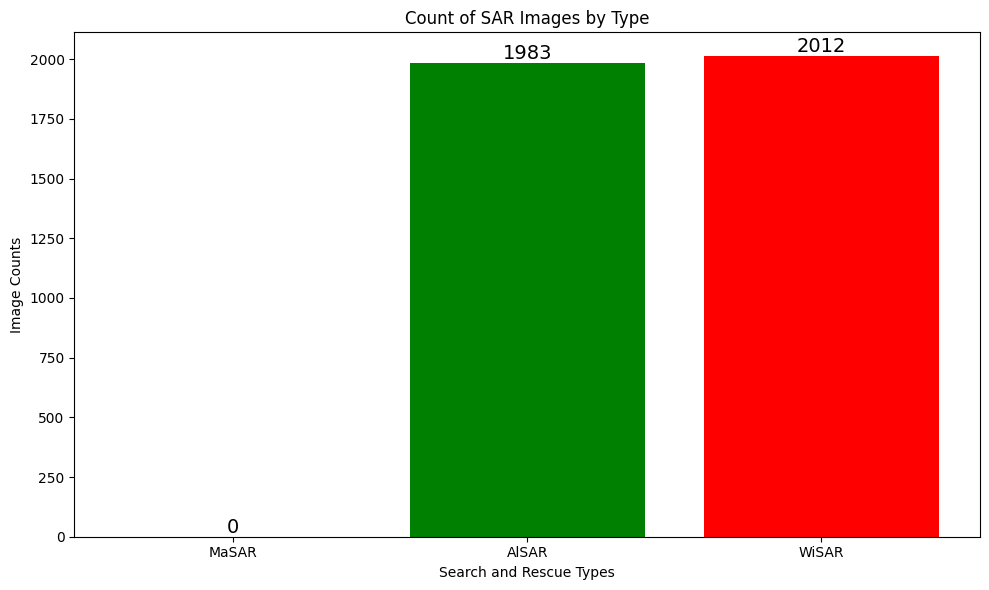

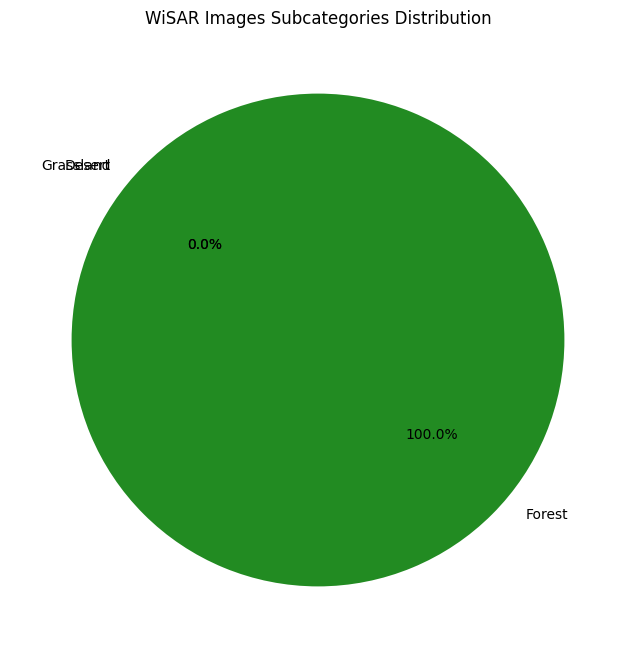

{'MaSAR': 0,
 'AlSAR': 1983,
 'WiSAR': 2012,
 'WiSAR-forest': 2012,
 'WiSAR-desert': 0,
 'WiSAR-grassland': 0}

In [ ]:
# !unzip -o '/content/drive/My Drive/Dissertation/Datasets/Labelled Datasets/WiSAR1.v1i.coco.zip' -d '/content/drive/My Drive/Dissertation/Datasets/Labelled Datasets/' -x '__MACOSX/*'
wisard = dataset_dir + 'WiSAR1.v1i.coco'

wisard_count = visualize_dataset(wisard)
show_environment_split(wisard,show_wilderness_split=True)

# [HERIDAL](http://ipsar.fesb.unist.hr/HERIDAL%20database.html)
The dataset contains  1577 labelled images from a wide range of enviroments - mostly including WiSAR & AlSAR based enviroments / terrains

loading annotations into memory...
Done (t=12.05s)
creating index...
index created!


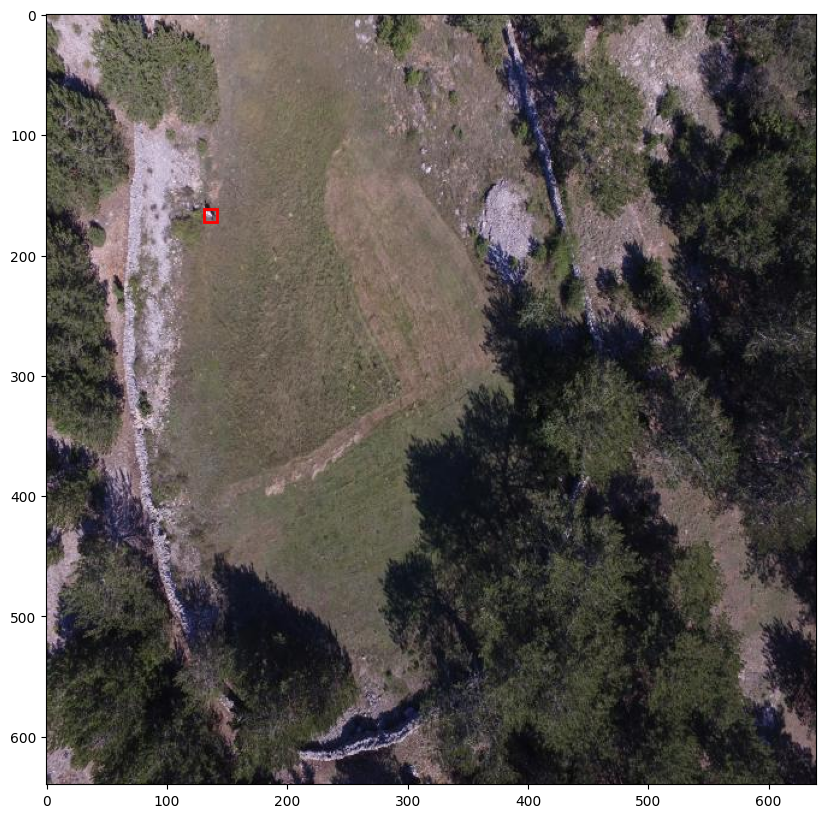

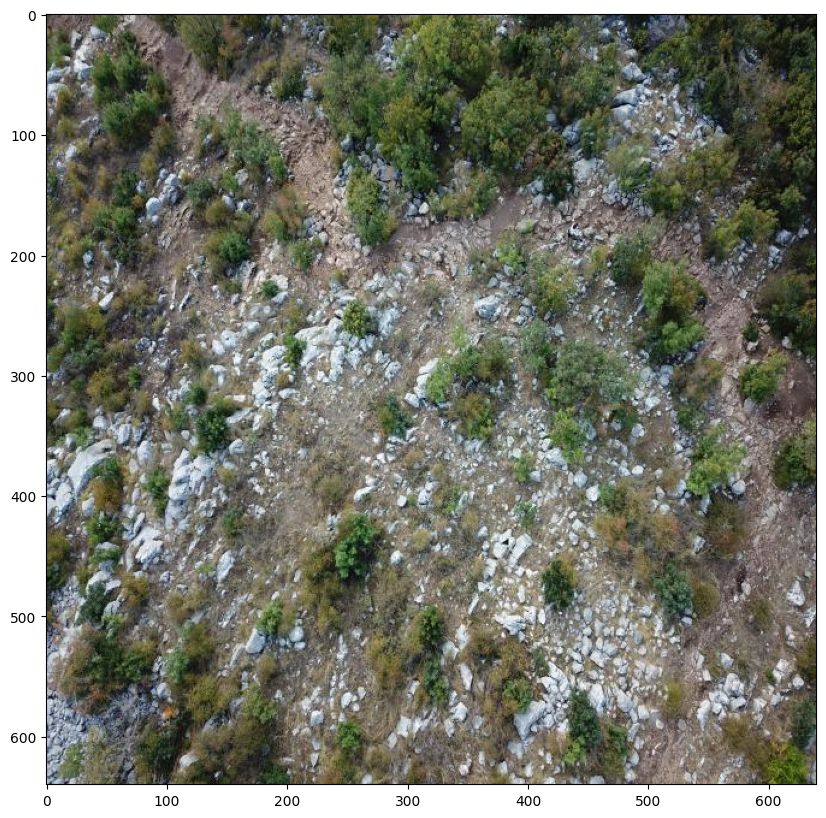

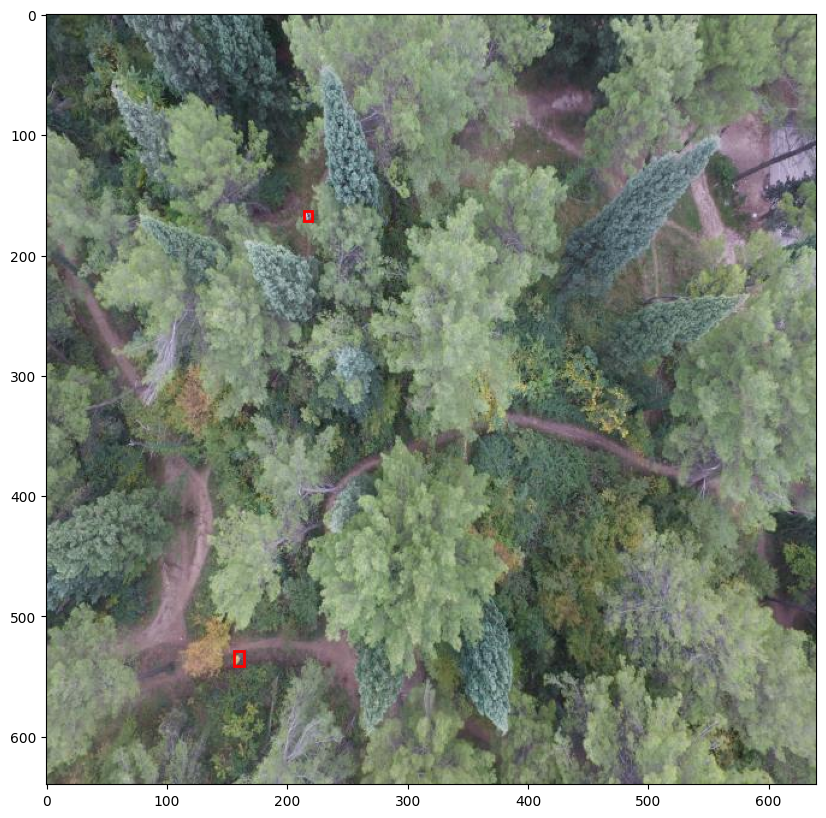

Number of images in dataset 1577


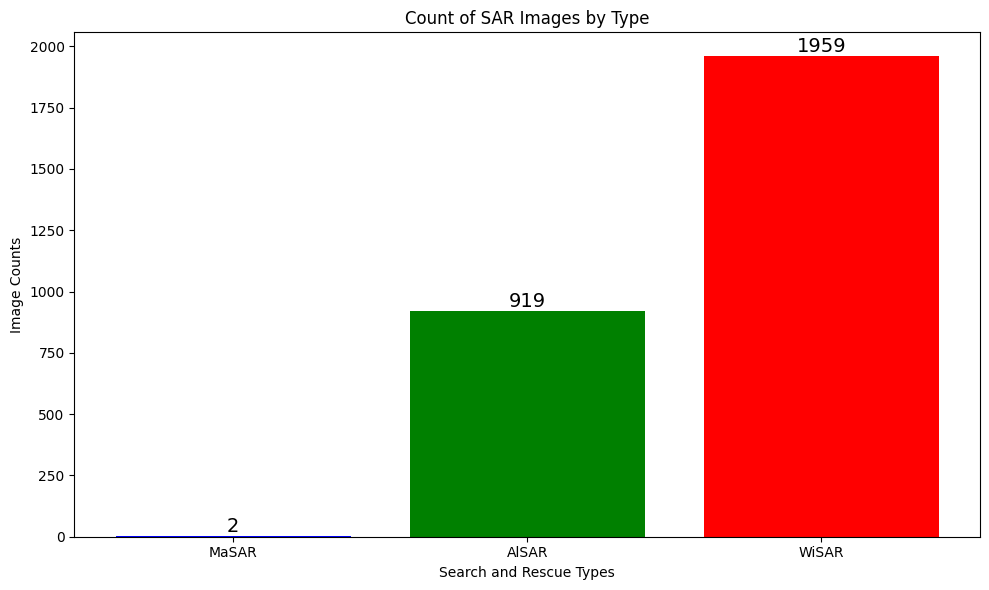

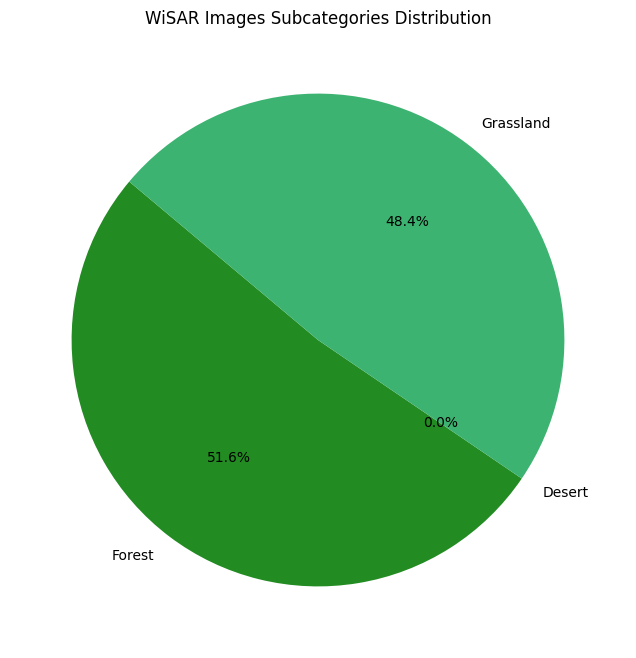

{'MaSAR': 2,
 'AlSAR': 919,
 'WiSAR': 1959,
 'WiSAR-forest': 1011,
 'WiSAR-desert': 0,
 'WiSAR-grassland': 948}

In [ ]:
# !unzip -o '/content/drive/My Drive/Dissertation/Datasets/Labelled Datasets/HERIDAL.v1i.coco.zip' -d '/content/drive/My Drive/Dissertation/Datasets/Labelled Datasets/' -x '__MACOSX/*'
heridal = dataset_dir + 'HERIDAL.v1i.coco'
heridal_count = visualize_dataset(heridal)
show_environment_split(heridal,show_wilderness_split=True)

# GTA SAR
This dataset comprises 1,469 synthetic images sourced from the in-game environments of the well-known video game GTA 5. It was developed to fill the gap in the availability of SAR/Person detection datasets specifically in non snowy mountainous AlSAR enviroments and WiSAR desert enviroments. This dataset was gathered and annotated by myself

loading annotations into memory...
Done (t=13.21s)
creating index...
index created!


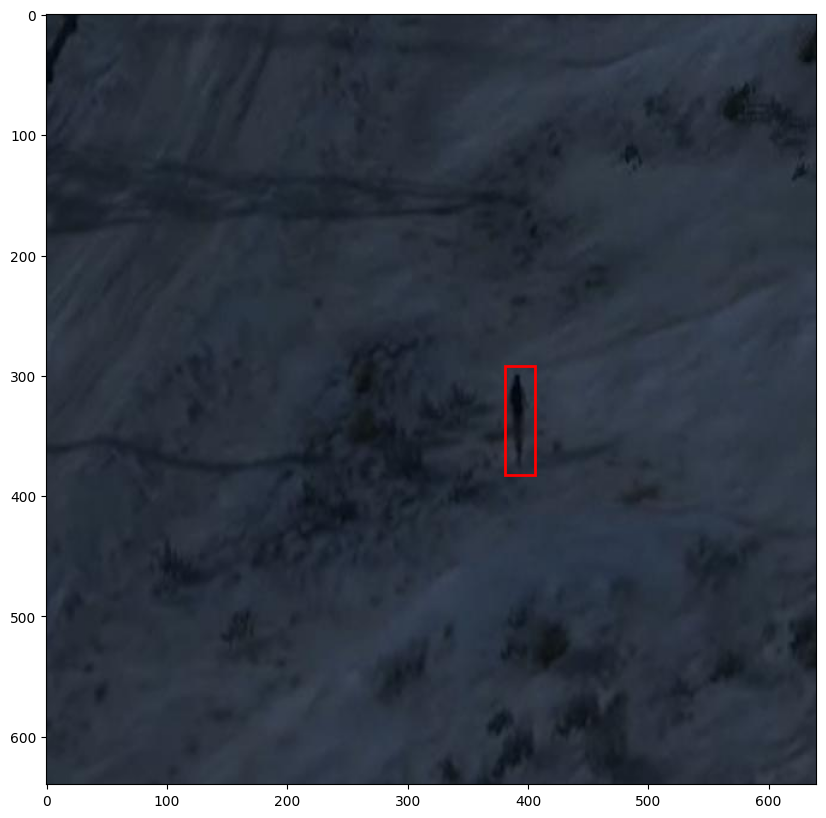

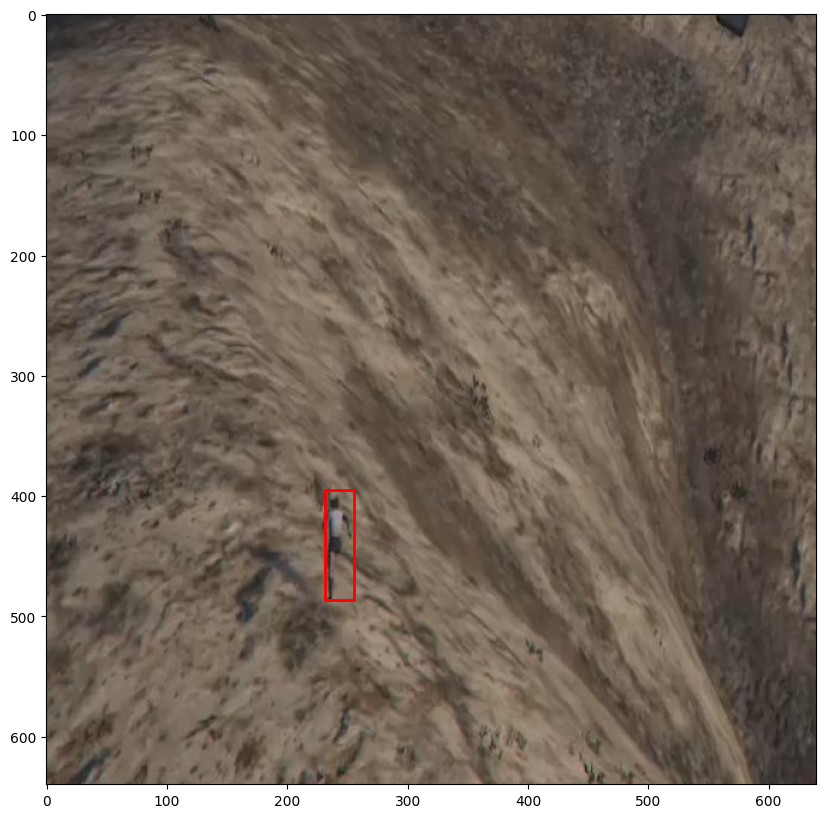

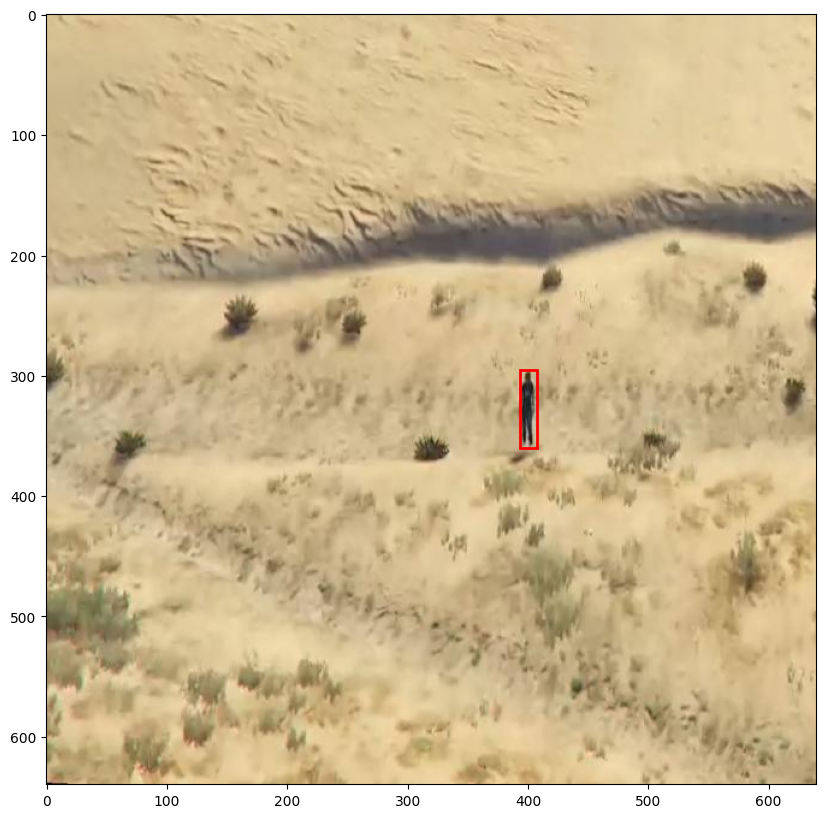

Number of images in dataset 1469


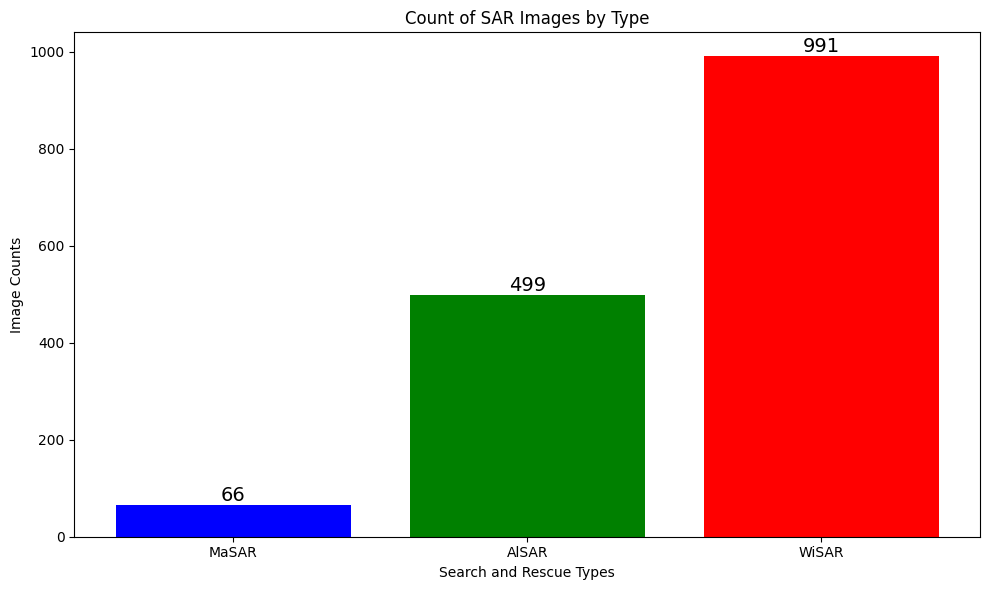

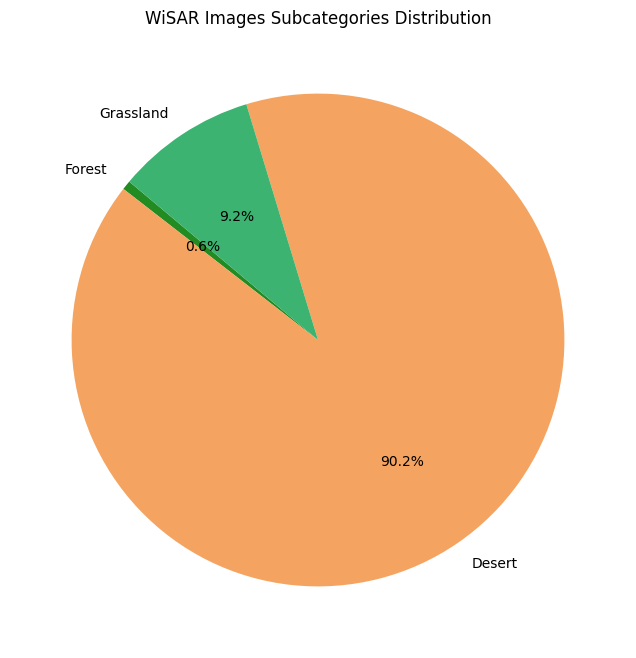

{'MaSAR': 66,
 'AlSAR': 499,
 'WiSAR': 991,
 'WiSAR-forest': 6,
 'WiSAR-desert': 893,
 'WiSAR-grassland': 91}

In [ ]:
# !unzip -o '/content/drive/My Drive/Dissertation/Datasets/Labelled Datasets/GTASar.v2i.coco.zip' -d '/content/drive/My Drive/Dissertation/Datasets/Labelled Datasets/' -x '__MACOSX/*'

gta = dataset_dir + 'GTASar.v2i.coco'


gta_count = visualize_dataset(gta)
show_environment_split(gta,show_wilderness_split=True)

# Final Dataset

**The following splits were aimed for:**
- Training set: 70%
- Validation set: 15%
- Test set: 15%

The percentages are not exact, because we aim to balance the enviroment types in each train,val,test set


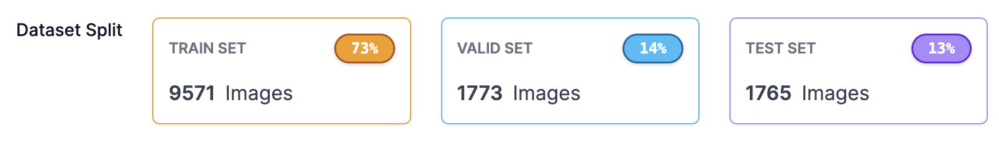

In [ ]:
final_count = heridal_count + sard_count + sea_count + gta_count + wisard_count
final_count_without_gta = heridal_count + sard_count + sea_count  + wisard_count
print(f"train count {0.7*final_count}")
print(f"test count {0.15*final_count}")
print(f"val count {0.15*final_count}")
print(final_count)

train count 9249.8
test count 1982.1
val count 1982.1
13214


# Health Check

In [ ]:


def accumulate_tag_counts(dir, folders=['train', 'test', 'valid'], dont_count_synthetic=False):
    tag_counts = {'MaSAR': 0, 'AlSAR': 0, 'WiSAR': 0, 'WiSAR-forest': 0, 'WiSAR-desert': 0, 'WiSAR-grassland': 0}

    for folder in folders:
        ann_file = os.path.join(dir, folder, '_annotations.coco.json')

        if not os.path.isfile(ann_file):
            print(f"File not found: {ann_file}")
            continue

        with open(ann_file, 'r') as f:
            data = json.load(f)

        # Process each image's tags to update counts
        for image in data['images']:
            tags = image.get("extra", {}).get("user_tags", [])
            if dont_count_synthetic == True and "synthetic" in tags:
              continue
            for tag in tags:
                if 'MaSAR' in tag or 'MiSAR' in tag:
                    tag_counts['MaSAR'] += 1
                if 'AlSAR' in tag:
                    tag_counts['AlSAR'] += 1
                if 'WiSAR' in tag:
                    tag_counts['WiSAR'] += 1
                    if 'forest' in tag:
                        tag_counts['WiSAR-forest'] += 1
                    if 'desert' in tag:
                        tag_counts['WiSAR-desert'] += 1
                    if 'grassland' in tag:
                        tag_counts['WiSAR-grassland'] += 1

    return tag_counts


In [ ]:


def visualize_tag_counts(tag_counts):
    # Base SAR categories
    sar_types = ['MaSAR', 'AlSAR', 'WiSAR']
    counts = [tag_counts[sar] for sar in sar_types]

    # Subcategories for WiSAR
    sub_categories = ['WiSAR-forest', 'WiSAR-desert', 'WiSAR-grassland']
    sub_counts = [tag_counts[tag] for tag in sub_categories]

    # Create main bar chart
    plt.figure(figsize=(10, 6))
    bars = plt.bar(sar_types, counts, color=['blue', 'green', 'red'])

    # Create a smaller bar chart for WiSAR subcategories directly on the WiSAR bar
    wiSar_index = sar_types.index('WiSAR')  # Find index for WiSAR bar
    plt.bar([wiSar_index], [sum(sub_counts)], width=0.5, color='gray', edgecolor='black', hatch="/")

    # Optionally, create separate small bars for each subcategory on/next to the WiSAR bar
    # Adjust positions as needed
    sub_bar_positions = [wiSar_index - 0.15, wiSar_index, wiSar_index + 0.15]
    plt.bar(sub_bar_positions, sub_counts, width=0.15, color=['forestgreen', 'sandybrown', 'mediumseagreen'])

    plt.title('Count of SAR Images by Type with WiSAR Subcategories')
    plt.xlabel('Search and Rescue Types')
    plt.ylabel('Image Counts')
    plt.xticks(range(len(sar_types)), sar_types)
    plt.tight_layout()
    plt.show()


In [ ]:


# accumulate tag counts
full_dataset_dir = '/content/drive/My Drive/Dissertation/Datasets/SARDet/full/'
accumulated_tag_counts = accumulate_tag_counts(full_dataset_dir, folders=['train'],dont_count_synthetic=False)


visualize_tag_counts(accumulated_tag_counts)
accumulated_tag_counts = accumulate_tag_counts(full_dataset_dir, folders=['valid'],dont_count_synthetic=False)


visualize_tag_counts(accumulated_tag_counts)
accumulated_tag_counts = accumulate_tag_counts(full_dataset_dir, folders=['test'],dont_count_synthetic=False)


visualize_tag_counts(accumulated_tag_counts)



***Annotation Heat Map***

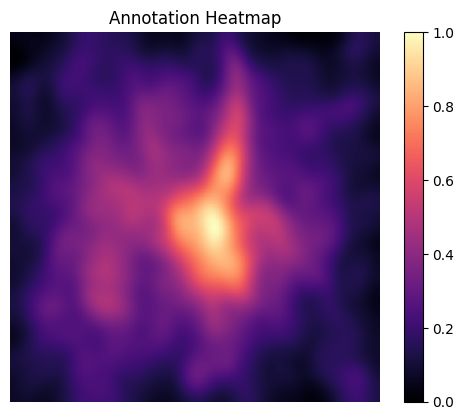

In [ ]:
def show_annotation_heatmap(directory):
    # Initialize an empty heatmap
    heatmap = None
    first_image_shape = None

    # Subdirectories to process
    subsets = ['train', 'test', 'valid']

    # Accumulate all annotations into one single heatmap
    for subset in subsets:
        subset_dir = os.path.join(directory, subset)
        annotation_file = os.path.join(subset_dir, '_annotations.coco.json')

        # Load annotations
        with open(annotation_file) as f:
            annotations = json.load(f)

        # Check if the first image shape is set, if not set it
        if first_image_shape is None:
            image_info = annotations['images'][0]
            image_path = os.path.join(subset_dir, image_info['file_name'])
            image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
            first_image_shape = image.shape
            heatmap = np.zeros(first_image_shape, dtype=np.float32)

        # Process each annotation
        for annotation in annotations['annotations']:
            # Find corresponding image info
            image_info = next((img for img in annotations['images'] if img['id'] == annotation['image_id']), None)
            if image_info is not None:
                image_path = os.path.join(subset_dir, image_info['file_name'])
                image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

                # If image size doesn't match first_image_shape, resize it
                if image.shape != first_image_shape:
                    image = cv2.resize(image, first_image_shape[::-1])

                # Extract bounding box and add it to the heatmap
                bbox = annotation['bbox']
                x_min, y_min, width, height = map(int, bbox)
                heatmap[y_min:y_min + height, x_min:x_min + width] += 1

    # Apply Gaussian filter to the heatmap to make it 'softer'
    heatmap_smoothed = gaussian_filter(heatmap, sigma=15)  # Increased sigma for more blur

    # Normalize the smoothed heatmap
    heatmap_normalized = cv2.normalize(heatmap_smoothed, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)

    # Plot the combined heatmap using a 'magma' colormap for warm tones
    plt.imshow(heatmap_normalized, cmap='magma', interpolation='nearest')
    plt.title('Annotation Heatmap')
    plt.axis('off')
    plt.colorbar()
    plt.show()


show_annotation_heatmap(full_dataset_dir)

# Terrain Specific Test Split
- 500 images for each terrain type
- Used to benchmark models performance on each terrain type

In [ ]:

wisar_dataset_dir = '/content/drive/My Drive/Dissertation/Datasets/SARDet/terrain_split/wisar'
alsar_dataset_dir = '/content/drive/My Drive/Dissertation/Datasets/SARDet/terrain_split/alsar'
masar_dataset_dir = '/content/drive/My Drive/Dissertation/Datasets/SARDet/terrain_split/masar'
full_dataset_dir = '/content/drive/My Drive/Dissertation/Datasets/SARDet/full/'
# # annotation file has _annotation.json format

In [ ]:


# Using a faster JSON library like orjson can significantly speed up the loading and saving of large JSON files.
try:
    import orjson as json_lib
except ImportError:
    import json as json_lib

def load_annotations_fast(annotation_path):
    with open(annotation_path, 'rb') as f:  # Use 'rb' for orjson compatibility
        annotations = json_lib.loads(f.read())
    image_filenames = {image['file_name']: image['id'] for image in annotations['images']}
    return image_filenames, annotations

def save_annotations_fast(annotation_path, annotations):
    with open(annotation_path, 'wb') as f:  # Write in binary mode for orjson
        f.write(json_lib.dumps(annotations, option=json_lib.OPT_INDENT_2))

def remove_overlaps_fast(test_set, train_set, annotations):
    overlap = test_set.keys() & train_set.keys()
    if overlap:
        overlap_ids = {test_set[filename] for filename in overlap}
        annotations['images'] = [img for img in annotations['images'] if img['file_name'] not in overlap]
        annotations['annotations'] = [anno for anno in annotations['annotations'] if anno['image_id'] not in overlap_ids]
        for filename in overlap:
            del test_set[filename]
    return test_set, annotations

def trim_to_500_images_fast(test_set, annotations):
    while len(test_set) > 500:
        removed_image, removed_id = random.choice(list(test_set.items()))
        del test_set[removed_image]
        annotations['images'] = [img for img in annotations['images'] if img['file_name'] != removed_image]
        annotations['annotations'] = [anno for anno in annotations['annotations'] if anno['image_id'] != removed_id]
    return test_set, annotations

# Assume `full_dataset_dir`, `wisar_dataset_dir`, `alsar_dataset_dir`, and `masar_dataset_dir` are defined elsewhere.
train_annotation_path = os.path.join(full_dataset_dir, 'train', '_annotations.coco.json')
train_images, _ = load_annotations_fast(train_annotation_path)

for dataset_dir in [wisar_dataset_dir, alsar_dataset_dir, masar_dataset_dir]:
    test_annotation_path = os.path.join(dataset_dir, 'test', '_annotations.coco.json')
    test_images, annotations = load_annotations_fast(test_annotation_path)

    test_images, annotations = remove_overlaps_fast(test_images, train_images, annotations)
    test_images, annotations = trim_to_500_images_fast(test_images, annotations)

    save_annotations_fast(test_annotation_path, annotations)

    existing_files = set(os.listdir(os.path.join(dataset_dir, 'test')))
    for file in existing_files:
        if file not in test_images and file.endswith(('jpg', 'png')):
            os.remove(os.path.join(dataset_dir, 'test', file))


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.5/138.5 kB 3.0 MB/s eta 0:00:00


In [ ]:
def count_images_in_folder(folder_path):
    """
    Counts the number of image files in a specified folder.

    Args:
    - folder_path (str): The path to the folder where the images are stored.

    Returns:
    - int: The number of image files found in the folder.
    """
    # List all files in the given folder
    files = os.listdir(folder_path)

    # Filter files to keep only those with common image extensions
    image_files = [file for file in files if file.endswith(('.jpg', '.jpeg', '.png', '.bmp', '.tif', '.tiff'))]

    # Return the count of image files
    return len(image_files)



# Data Augmentation - Simulating Video Streaming
 -  how different types of visual (such as bitrate compression, packet-loss, and frame-freezing) and auditory distortions impact the quality of audio-visual content.
- Buffering Artifacts
- Pixelation
- Banding
- Mosquito Noise

loading annotations into memory...
Done (t=0.73s)
creating index...
index created!


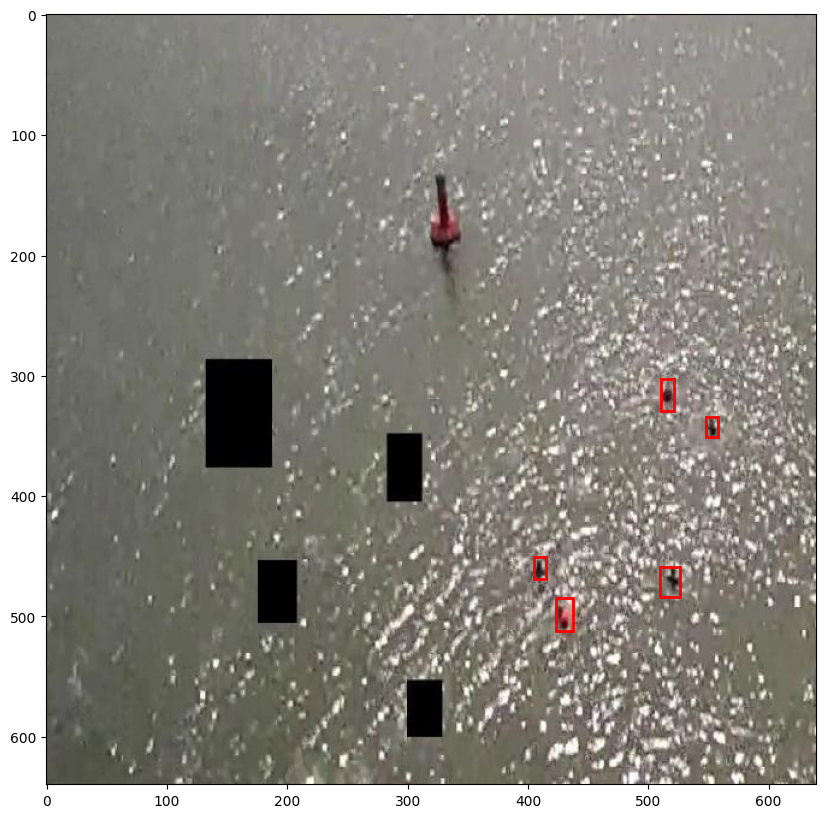

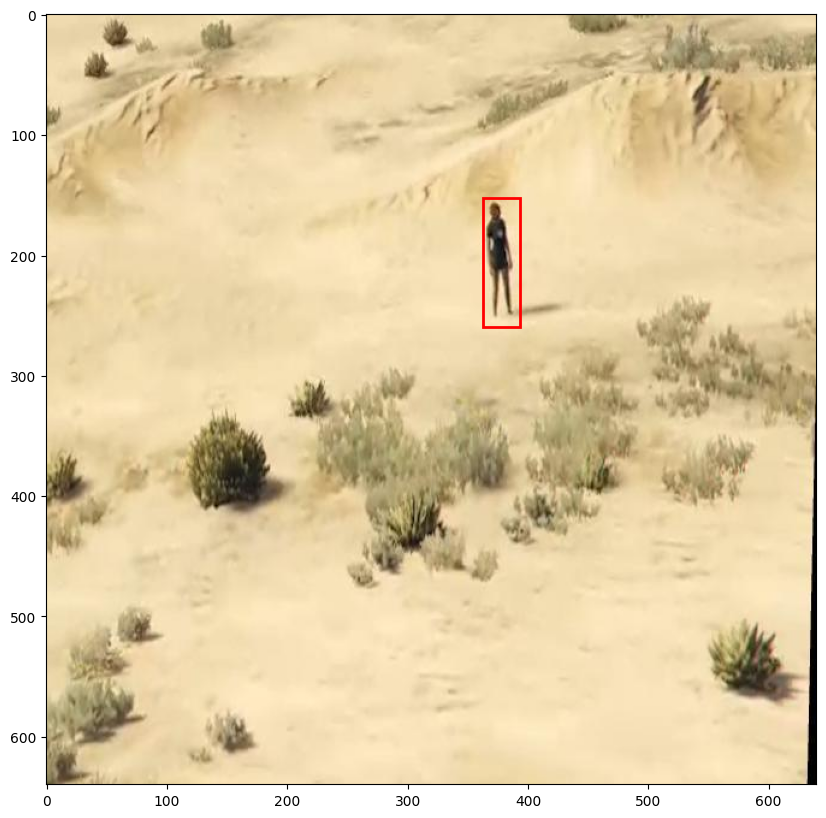

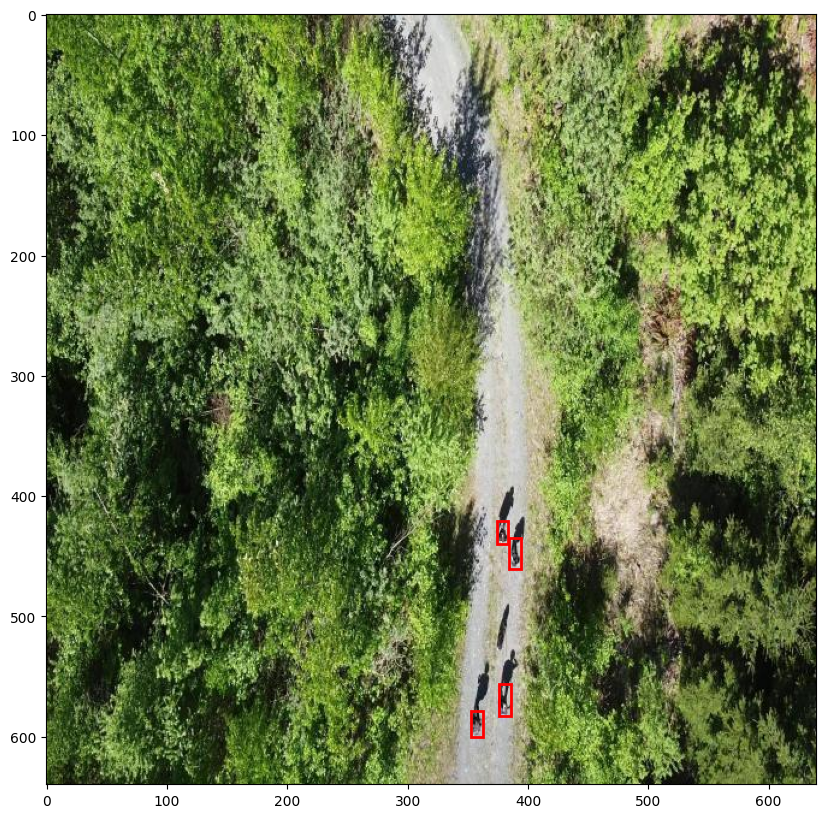

Number of images in dataset 9571


In [ ]:
# load in complete data and apply data transformation techniques
full_dataset_dir = '/content/drive/My Drive/Dissertation/Datasets/SARDet/full/'
visualize_dataset(full_dataset_dir)

# check that folder doesnt exist

if os.path.exists(full_dataset_dir) and os.path.isdir(full_dataset_dir):
  pass
  # folder alr exists
else:
  # create folder for the augmented data
  !mkdir /content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented

In [ ]:
# augementation functions


from PIL import Image
import io

example_image = get_first_image_path('/content/drive/My Drive/Dissertation/Datasets/SARDet/full/train/')



def apply_compression_artifacts(image_path, output_path=None, quality=50):
    img = Image.open(image_path)
    if output_path:
        # Save the image with the specified quality
        img.save(output_path, 'JPEG', quality=quality)
    else:
        # If no output path is provided, save to a buffer and then display the image
        with io.BytesIO() as buf:
            img.save(buf, 'JPEG', quality=quality)
            buf.seek(0)
            img = Image.open(buf)
            img_array = np.array(img)
            # Convert RGB to BGR for cv2 compatibility
            img_array = img_array[:, :, ::-1]
            return img_array


def apply_pixelation(image_path, output_path=None, pixelation_level=0.05):
    """
    Apply a pixelation effect to an image.
    If output_path is None, returns the image as a numpy array.
    :param image_path: Path to the input image.
    :param output_path: Path where the output image will be saved, or None to return the image.
    :param pixelation_level: Level of pixelation, smaller values mean more pixelated. Range (0, 1].
    :return: Image as a numpy array if output_path is None, else None.
    """
    img = cv2.imread(image_path)
    h, w = img.shape[:2]
    # Resize down
    img_small = cv2.resize(img, (int(w * pixelation_level), int(h * pixelation_level)), interpolation=cv2.INTER_LINEAR)
    # Resize back to original size
    img_pixelated = cv2.resize(img_small, (w, h), interpolation=cv2.INTER_NEAREST)
    if output_path:
        cv2.imwrite(output_path, img_pixelated)
    else:
        return img_pixelated





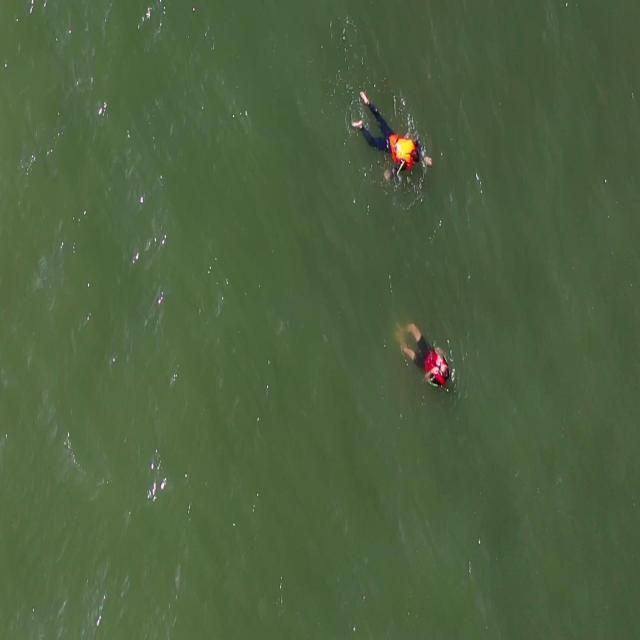

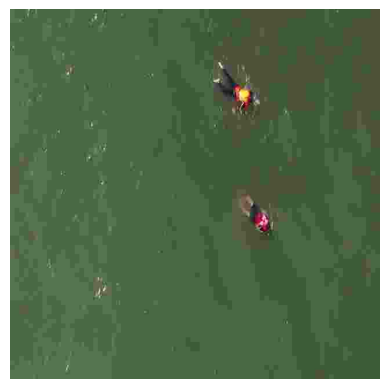

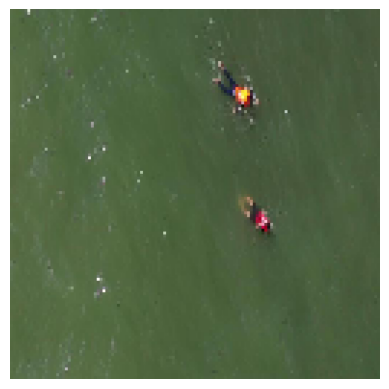

In [ ]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
from PIL import Image
import io
from IPython.display import Image as IPythonImage


# Make sure you've defined get_first_image_path somewhere above this code.

def display_image(image_array):
    """
    Display an image given as a NumPy array.
    :param image_array: NumPy array representing the image.
    """
    if image_array.ndim == 2:  # If grayscale, convert to a colormap
        plt.imshow(image_array, cmap='gray')
    else:
        plt.imshow(cv2.cvtColor(image_array, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

# Use the functions and display images.
example_image_path = '/content/drive/My Drive/Dissertation/Datasets/Labelled Datasets/SeaDroneSee.v1i.coco/train/daemon.jpg'
display(IPythonImage(filename=example_image_path))
# Apply compression artifacts and display
# between 5-10
compressed_image_array = apply_compression_artifacts(example_image_path, None, quality=8)
display_image(compressed_image_array)

# Apply pixelation and display

pixelated_image_array = apply_pixelation(example_image_path, None, pixelation_level=0.2)
display_image(pixelated_image_array)


In [ ]:
!rm -r '/content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/train/'
!rm -r '/content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/valid/'
!rm -r '/content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/test/'

In [ ]:
def random_augmentation(image_path, output_path):
    # Randomly choose the augmentation type
    augmentation_type = random.choice(['compression', 'pixelation'])

    if augmentation_type == 'compression':
        # Randomly choose quality between 40 and 70 quality for compression
        quality = random.randint(50, 70)
        compressed_image = apply_compression_artifacts(image_path, None, quality=quality)
        # Since apply_compression_artifacts returns an array when output_path is None, save the array as an image
        Image.fromarray(compressed_image).save(output_path)
    else:
        # Randomly choose pixelation level between 0.1 and 0.3
        pixelation_level = random.uniform(0.4, 0.6)
        pixelated_image = apply_pixelation(image_path, None, pixelation_level=pixelation_level)
        # Since apply_pixelation returns an array when output_path is None, save the array as an image
        cv2.imwrite(output_path, pixelated_image)
        print("image saved to:", output_path)

In [ ]:
from google.colab import files
!cd '/content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/' && ls


aug.zip  README.dataset.txt  README.roboflow.txt  test	train  valid


In [ ]:
def augment_images_in_directory(directory_path, save_in_same_dir=True):
    for root, dirs, files in os.walk(directory_path):
        image_files = [os.path.join(root, file) for file in files if file.endswith(('.png', '.jpeg', '.jpg'))]

        if image_files:  # Check if there are any image files to augment
            # Randomly select 10% of images for augmentation, ensuring there's at least one file if the directory is not empty
            images_to_augment = random.sample(image_files, max(1, len(image_files) // 10))

            for image_path in images_to_augment:
                original_file_name = os.path.basename(image_path)
                # Create a new file name by adding a suffix to the original name
                name_part, extension = os.path.splitext(original_file_name)
                augmented_file_name = f"{name_part}_augmented{extension}"

                if save_in_same_dir:
                    augmented_image_path = os.path.join(root, augmented_file_name)
                else:
                    # Specify or create a subdirectory to save augmented images
                    augmented_dir = os.path.join(root, "augmented")
                    os.makedirs(augmented_dir, exist_ok=True)
                    augmented_image_path = os.path.join(augmented_dir, augmented_file_name)

                random_augmentation(image_path, augmented_image_path)  # Pass the augmented image path to your function
                print("augemtation applied to,", augmented_image_path)
        else:
            print(f"No images found in {root} for augmentation.")

# Define your dataset directory and subdirectories
aug_dataset_dir = '/content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/'
sub_dirs = ['train', 'test', 'val']

for sub_dir in sub_dirs:
    full_path = os.path.join(aug_dataset_dir, sub_dir)
    augment_images_in_directory(full_path)


print("transfomrations applied ")



image saved to: /content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/train/Grand-Theft-Auto-V-2024-03-19-17-42-15-00_00_18_11-Still020_png_jpg.rf.d6ada4aba324b1d831859271e2f23c48_augmented.jpg
augemtation applied to, /content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/train/Grand-Theft-Auto-V-2024-03-19-17-42-15-00_00_18_11-Still020_png_jpg.rf.d6ada4aba324b1d831859271e2f23c48_augmented.jpg
augemtation applied to, /content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/train/train_GOR_2065_jpg.rf.771e3c5b1484ed99f92e17122f94139a_augmented.jpg
augemtation applied to, /content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/train/13222_jpg.rf.80f3df4a3a76df800c72143981650b72_augmented.jpg
image saved to: /content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/train/train_VRD_3046_jpg.rf.4d4f50c1261c277e16b9ae71ebfaab03_augmented.jpg
augemtation applied to, /content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/

In [ ]:
!zip -r '/content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/downloadme.zip' '/content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/'

Streaming output truncated to the last 5000 lines.
  adding: content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/train/gss1043_jpg.rf.69dccf377a1b798fac485af222bcf761.jpg (deflated 0%)
  adding: content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/train/gss1044_jpg.rf.fdc387de459831519ef0375c4ab7b27f.jpg (deflated 0%)
  adding: content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/train/gss1045_jpg.rf.ddc591273061435e160684485df6cfcd.jpg (deflated 0%)
  adding: content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/train/gss1046_jpg.rf.110ba8f274344a4120c0b5ed4af57b98.jpg (deflated 0%)
  adding: content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/train/gss1049_jpg.rf.f91a6ed2afdfd23eb8d5f2b4775053cd.jpg (deflated 0%)
  adding: content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/train/gss1050_jpg.rf.f8a05be0d9c1850a53970cf9af34d5ba.jpg (deflated 0%)
  adding: content/drive/My Drive/Dissertation/Datasets/

In [ ]:
from google.colab import files
!cd '/content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/' && ls

# !mkdir '/content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/hello'
files.download('/content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/downloadme.zip')


aug.zip  downloadme.zip  hello	README.dataset.txt  README.roboflow.txt  test  train  valid


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
!cd '/content/drive/My Drive/Dissertation/Datasets/SARDet/full_augmented/' && ls

aug.zip  downloadme.zip  hello	README.dataset.txt  README.roboflow.txt  test  train  valid
